<a href="https://colab.research.google.com/github/Kirthanm/Detectron2-Object-segmentation/blob/main/Web_market_analysis_PD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [8]:
cd /content/drive/MyDrive/Parallel\ dots

/content/drive/MyDrive/Parallel dots


In [9]:
ls

coco_eval/  detectron2_repo/  output/
data/       objects/          WebMarket_coco_gt_object.csv


Insatlling detectron 2

In [5]:
!pip install -q cython pyyaml==5.1

     |████████████████████████████████| 276kB 33.6MB/s 


In [6]:
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

In [4]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 12230, done.
remote: Counting objects: 100% (137/137), done.
remote: Compressing objects: 100% (87/87), done.
remote: Total 12230 (delta 59), reused 117 (delta 50), pack-reused 12093
Receiving objects: 100% (12230/12230), 4.85 MiB | 25.19 MiB/s, done.
Resolving deltas: 100% (8902/8902), done.


In [7]:
!pip install -q -e detectron2_repo

     |████████████████████████████████| 51kB 7.4MB/s 
     |████████████████████████████████| 81kB 10.5MB/s 
     |████████████████████████████████| 153kB 41.5MB/s 
     |████████████████████████████████| 133kB 52.0MB/s 
     |████████████████████████████████| 112kB 45.5MB/s 
     |████████████████████████████████| 727kB 45.1MB/s 
     |████████████████████████████████| 747kB 50.3MB/s 


In [11]:
!pip install -q -U watermark

In [12]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.8.1+cu101 True


In [13]:
import torch
assert torch.__version__.startswith("1.8")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html


In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [5]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import glob,os,ntpath,cv2,random,itertools,urllib,json

import numpy as np

import pandas as pd
from tqdm import tqdm

import PIL.Image as Image
from google.colab.patches import cv2_imshow

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt

In [10]:
import pandas as pd

df = pd.read_csv('WebMarket_coco_gt_object.csv')
df.head()

,image_name,x1,y1,x2,y2,class
0,db1.jpg,1105,919,1315,1127,object
1,db1.jpg,191,1242,398,1469,object
2,db1.jpg,1587,697,1906,761,object
3,db1.jpg,1541,442,1845,541,object
4,db1.jpg,1252,505,1398,761,object


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118388 entries, 0 to 118387
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  118388 non-null  object
 1   x1          118388 non-null  int64 
 2   y1          118388 non-null  int64 
 3   x2          118388 non-null  int64 
 4   y2          118388 non-null  int64 
 5   class       118388 non-null  object
dtypes: int64(4), object(2)
memory usage: 5.4+ MB


In [15]:
ls

coco_eval/  detectron2_repo/  output/
data/       objects/          WebMarket_coco_gt_object.csv


In [31]:
path = '/content/drive/MyDrive/Parallel dots/data'

In [32]:
df_new = pd.DataFrame()
for each in os.listdir('data'):
  for img_name in os.listdir(path+'/'+each):
    d = df[df['image_name'] == img_name]
    d['file_path'] = f'{each}/{img_name}'
    df_new = pd.concat([df_new,d])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [33]:
df_new.head()

,image_name,x1,y1,x2,y2,class,file_path
41703,db601.jpg,1324,975,1940,1262,object,db3/db601.jpg
41704,db601.jpg,1466,488,2103,819,object,db3/db601.jpg
41705,db601.jpg,1088,117,1207,461,object,db3/db601.jpg
41706,db601.jpg,1361,124,1490,517,object,db3/db601.jpg
41707,db601.jpg,957,99,1067,486,object,db3/db601.jpg


In [34]:
df_new.shape

(41930, 7)

In [35]:
os.makedirs('objects',exist_ok=True)

In [36]:
unique_img = df_new.image_name.unique()
df_new = df_new.rename(columns=  {'class' : 'class_name'})

In [37]:
train_files = set(np.random.choice(unique_img, int(len(unique_img) * 0.90), replace=False))
train_df = df_new[df_new['image_name'].isin(train_files)]
test_df = df_new[~df_new['image_name'].isin(train_files)]

In [38]:
train_df.shape,test_df.shape

((37429, 7), (4501, 7))

In [39]:
train_df.head()

,image_name,x1,y1,x2,y2,class_name,file_path
41703,db601.jpg,1324,975,1940,1262,object,db3/db601.jpg
41704,db601.jpg,1466,488,2103,819,object,db3/db601.jpg
41705,db601.jpg,1088,117,1207,461,object,db3/db601.jpg
41706,db601.jpg,1361,124,1490,517,object,db3/db601.jpg
41707,db601.jpg,957,99,1067,486,object,db3/db601.jpg


In [40]:
classes = df_new['class_name'].unique().tolist()

In [41]:
classes

['object']

In [42]:
def create_df_dicts(df, classes):
  df_dicts = []
  for image_id, img_name in enumerate(df.image_name.unique()):
    record = {}
    image_df = df[df.image_name==img_name]
    record['file_name'] = path+'/'+image_df.file_path.values[0]
    record['image_id'] = image_id
    # print(path+'/'+image_df.file_path.values[0])
    try:
      record['height'],record['width'] = cv2.imread(path+'/'+image_df.file_path.values[0]).shape[:2]
    except:
      continue
    # print(record['height'],record['width'])
    objs = []
    for i,row in image_df.iterrows():
      x1 = int(row.x1)
      y1 = int(row.y1)
      x2 = int(row.x2)
      y2 = int(row.y2)

      poly = [
               (x1,y1),(x2,y1),
              (x2,y2),(x1,y2)
               ]
      poly = list(itertools.chain.from_iterable(poly))
      obj = {
          'bbox' : [x1,y1,x2,y2],
          'bbox_mode':BoxMode.XYXY_ABS,
          'segmentation':[poly],
          'category_id':classes.index(row.class_name),
          }
      objs.append(obj)
    record['annotations'] =objs
    df_dicts.append(record)
  return df_dicts  


In [44]:
for d in ['train','val']:
  DatasetCatalog.register('objects_'+d, lambda d=d:create_df_dicts(train_df if d == 'train' else test_df,classes))
  MetadataCatalog.get('objects_'+d).set(thing_classes=classes)
statement_metadata = MetadataCatalog.get('objects_train')

AssertionError: ignored

In [45]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [46]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("objects_train",)
cfg.DATASETS.TEST = ("objects_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025 
cfg.SOLVER.WARMUP_ITERS = 100
cfg.SOLVER.MAX_ITER = 200  
cfg.SOLVER.STEPS = (100, 150)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  
cfg.TEST.EVAL_PERIOD = 200
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/25 12:40:25 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in th

[05/25 12:42:39 d2.engine.train_loop]: Starting training from iteration 0
[05/25 12:43:07 d2.utils.events]:  eta: 0:04:01  iter: 19  total_loss: 2.718  loss_cls: 0.7001  loss_box_reg: 0.7556  loss_mask: 0.6875  loss_rpn_cls: 0.4586  loss_rpn_loc: 0.1583  time: 1.3765  data_time: 0.0524  lr: 2.5775e-05  max_mem: 5365M
[05/25 12:43:35 d2.utils.events]:  eta: 0:03:35  iter: 39  total_loss: 2.265  loss_cls: 0.6137  loss_box_reg: 0.7435  loss_mask: 0.6023  loss_rpn_cls: 0.1344  loss_rpn_loc: 0.1603  time: 1.3766  data_time: 0.0063  lr: 5.0275e-05  max_mem: 5365M
[05/25 12:44:00 d2.utils.events]:  eta: 0:03:06  iter: 59  total_loss: 2.022  loss_cls: 0.5392  loss_box_reg: 0.7598  loss_mask: 0.4786  loss_rpn_cls: 0.08107  loss_rpn_loc: 0.1121  time: 1.3438  data_time: 0.0063  lr: 7.4775e-05  max_mem: 5365M
[05/25 12:44:27 d2.utils.events]:  eta: 0:02:39  iter: 79  total_loss: 1.869  loss_cls: 0.4945  loss_box_reg: 0.7923  loss_mask: 0.381  loss_rpn_cls: 0.07654  loss_rpn_loc: 0.1174  time: 1.3

In [47]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

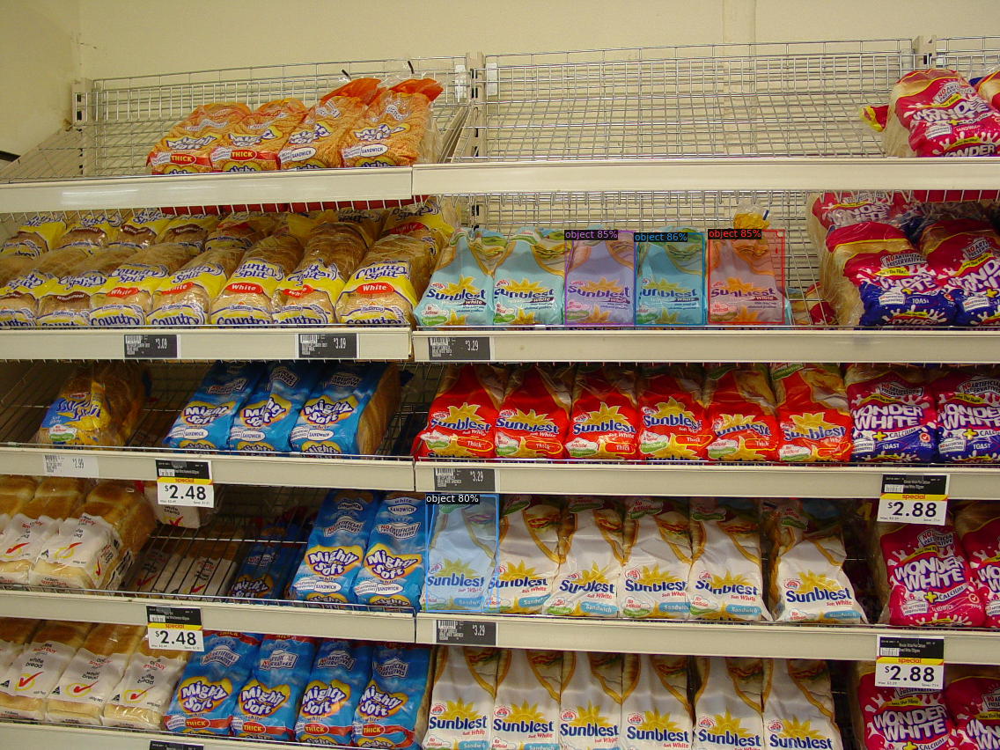

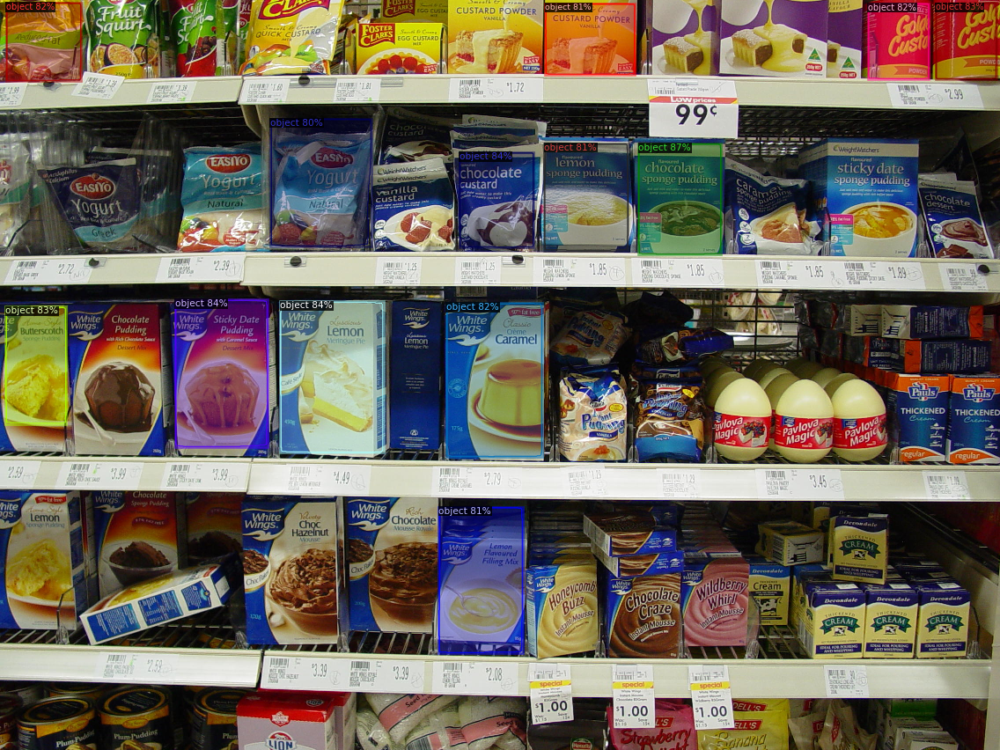

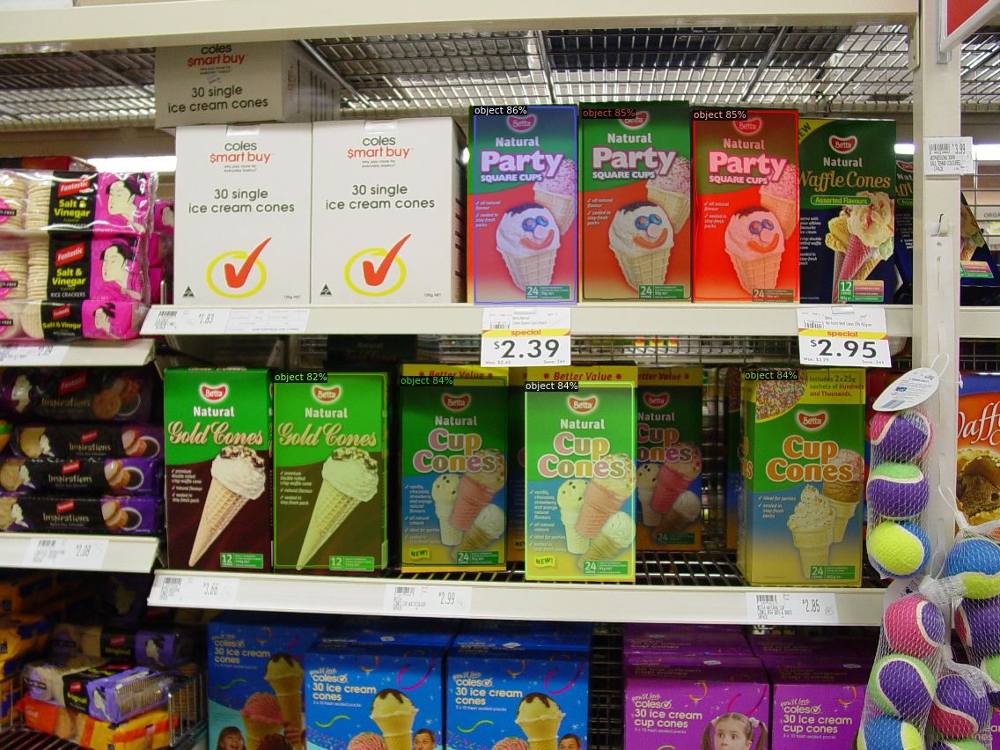

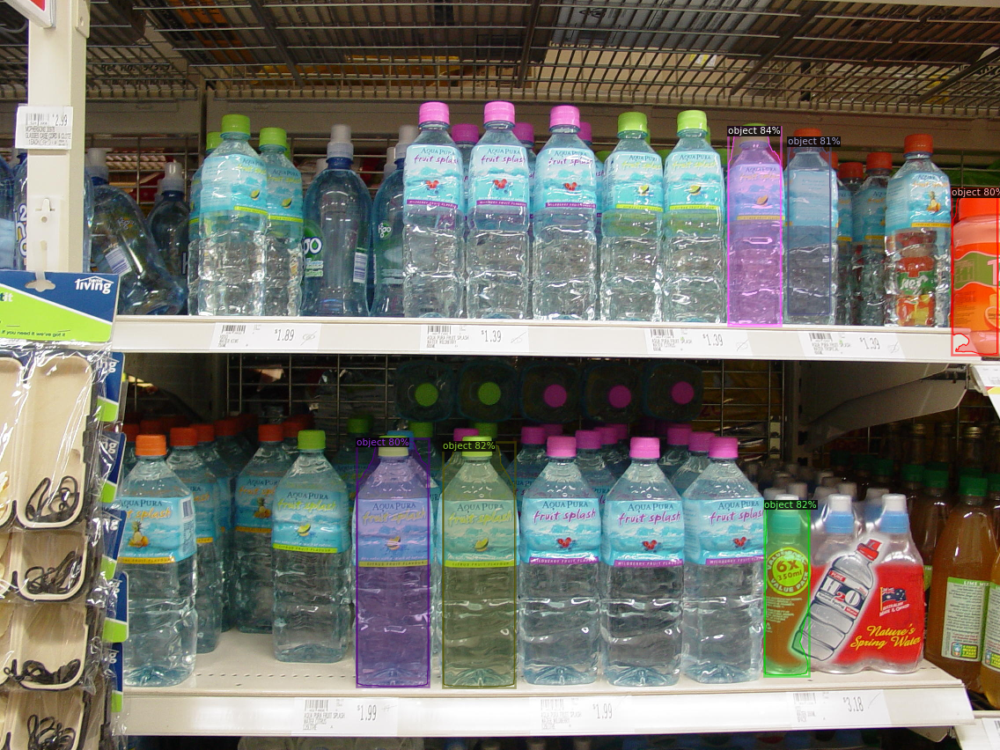

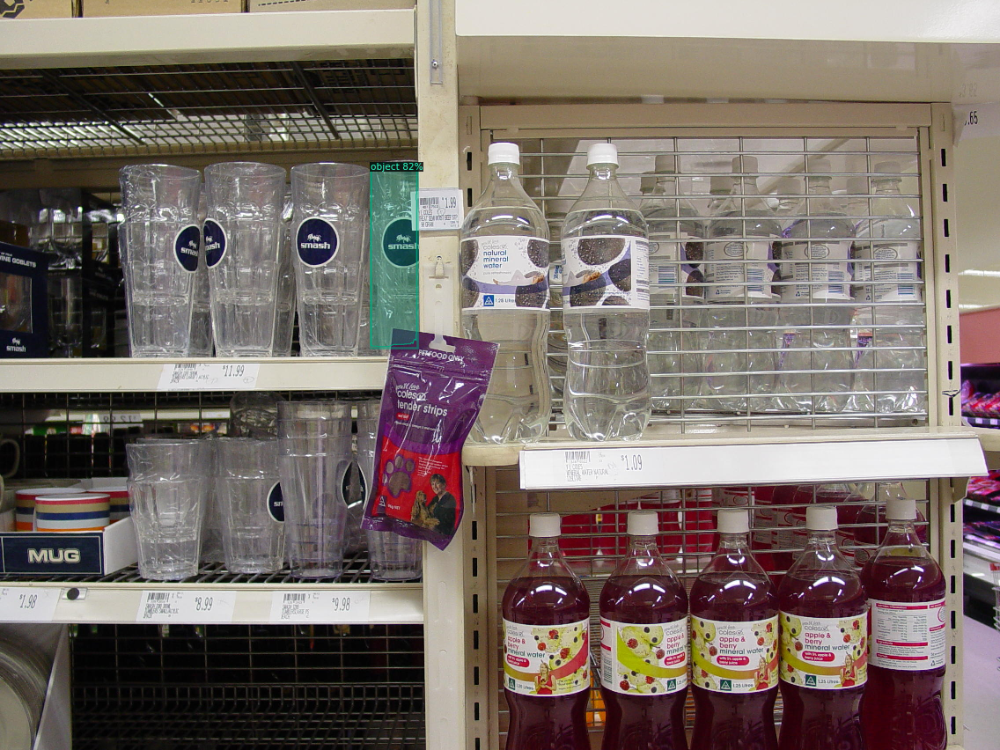

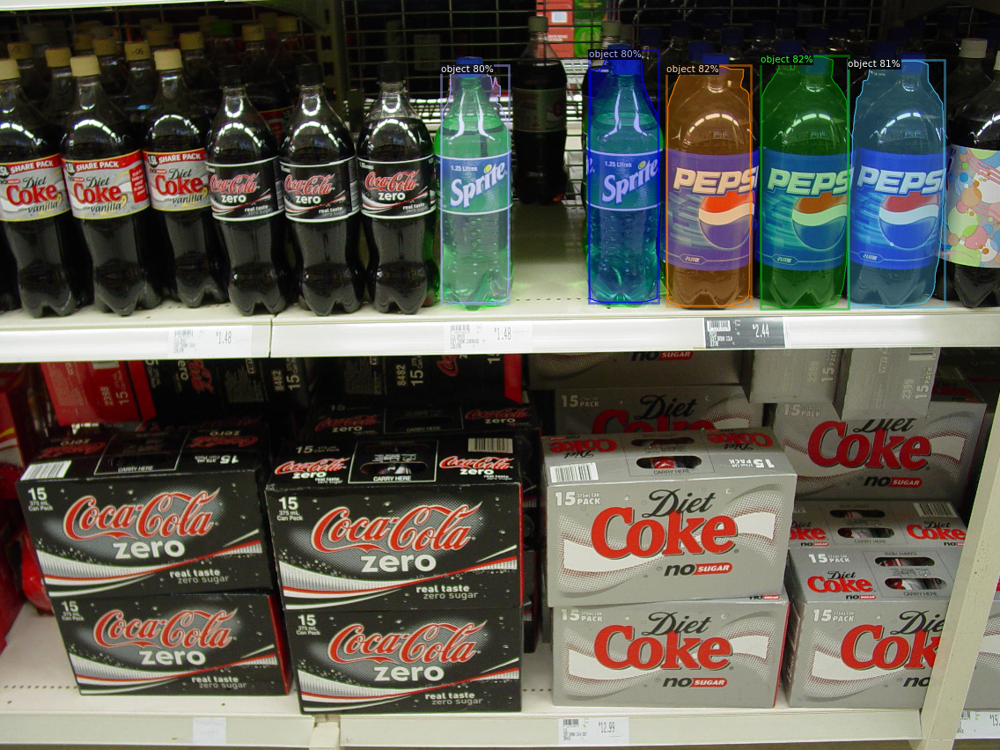

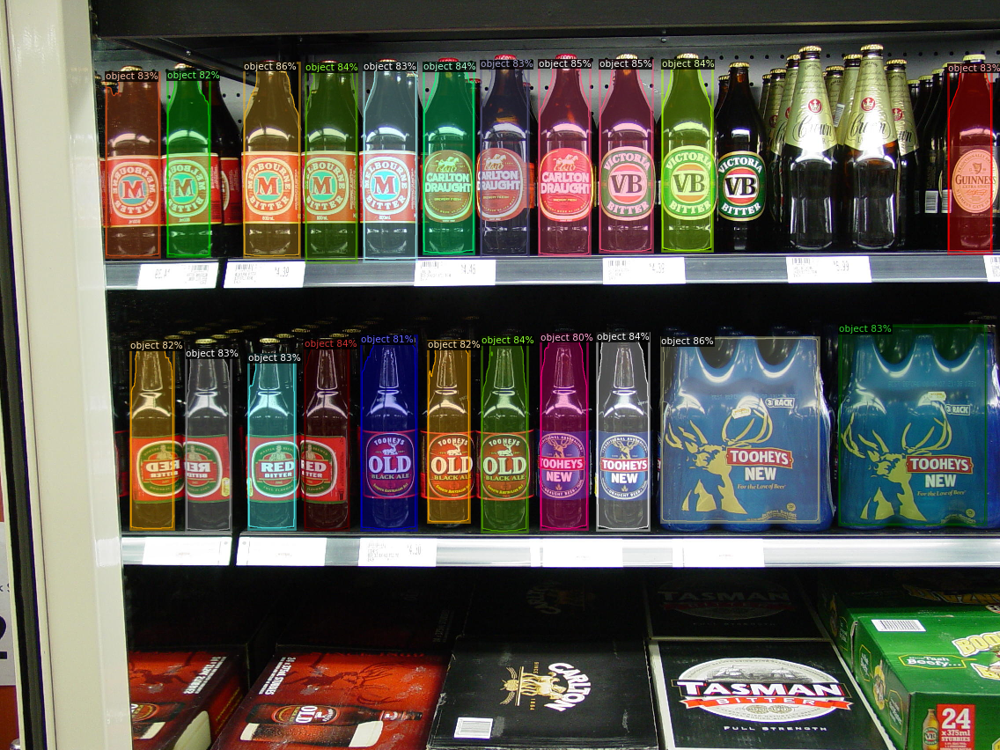

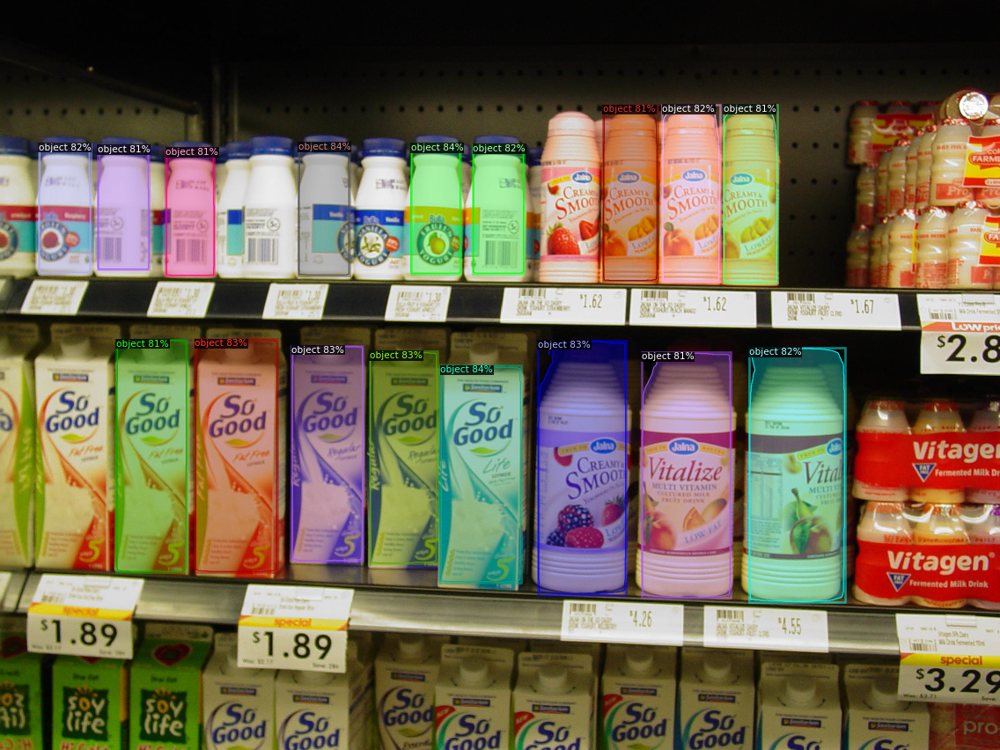

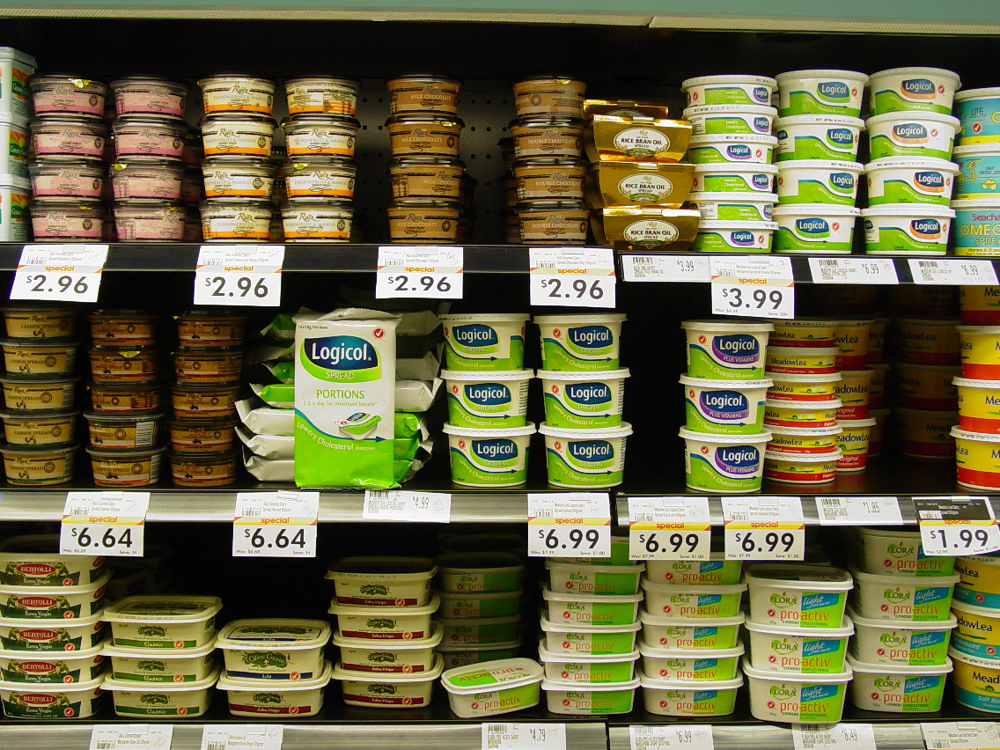

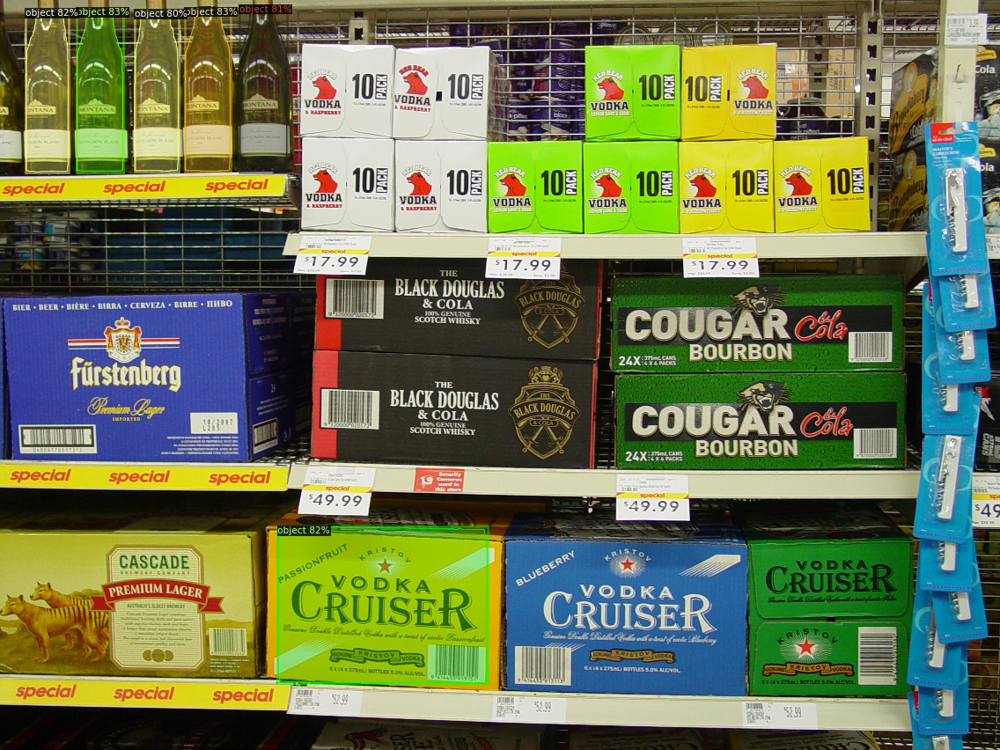

In [48]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = create_df_dicts(test_df, classes)
for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=statement_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [49]:
evaluator = COCOEvaluator("objects_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "objects_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [05/25 12:53:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/25 12:53:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/25 12:53:12 d2.data.common]: Serializing 120 elements to byte tensors and concatenating them all ...
[05/25 12:53:12 d2.data.common]: Serialized dataset takes 0.29 MiB
[05/25 12:53:12 d2.evaluation.evaluator]: Start inference on 120 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[05/25 12:53:28 d2.evaluation.evaluator]: Inference done 11/120. Dataloading: 0.0014 s / iter. Inference: 0.3886 s / iter. Eval: 0.9330 s / iter. Total: 1.3230 s / iter. ETA=0:02:24
[05/25 12:53:33 d2.evaluation.evaluator]: Inference done 15/120. Dataloading: 0.0024 s / iter. Inference: 0.3896 s / iter. Eval: 0.9312 s / iter. Total: 1.3234 s / iter. ETA=0:02:18
[05/25 12:53:38 d2.evaluation.evaluator]: Inference done 19/120. Dataloading: 0.0022 s / iter. Inference: 0.3900 s / iter. Eval: 0.9306 s / iter. Total: 1.3231 s / iter. ETA=0:02:13
[05/25 12:53:44 d2.evaluation.evaluator]: Inference done 23/120. Dataloading: 0.0022 s / iter. Inference: 0.3901 s / iter. Eval: 0.9303 s / iter. Total: 1.3229 s / iter. ETA=0:02:08
[05/25 12:53:49 d2.evaluation.evaluator]: Inference done 27/120. Dataloading: 0.0021 s / iter. Inference: 0.3901 s / iter. Eval: 0.9322 s / iter. Total: 1.3247 s / iter. ETA=0:02:03
[05/25 12:53:54 d2.evaluation.evaluator]: Inference done 31/120. Dataloading: 0.0021 s / i

OrderedDict([('bbox',
              {'AP': 0.4060499355459814,
               'AP50': 1.0594780721566888,
               'AP75': 0.004552179355866622,
               'APl': 0.40678307567028726,
               'APm': 0.000980296049406921,
               'APs': 0.0}),
             ('segm',
              {'AP': 0.017957728559823617,
               'AP50': 0.07522279397089578,
               'AP75': 0.005690224194833277,
               'APl': 0.018181702805215902,
               'APm': 0.0006875687568756875,
               'APs': 0.0})])

In [50]:
os.makedirs("annotated_results", exist_ok=True)
test_image_paths = test_df.file_path.unique()


In [62]:
for test_image in test_image_paths:
  im = cv2.imread(path+'/'+test_image)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=0.8, 
    instance_mode=ColorMode.IMAGE_BW
  )
  instances = outputs["instances"].to("cpu")
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(test_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [63]:
annotated_images = [f'annotated_results/{f}' for f in test_df.image_name.unique()]

(-0.5, 1816.5, 1362.5, -0.5)

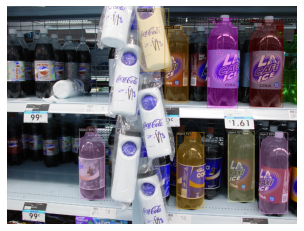

In [64]:
img = cv2.imread(annotated_images[20])

plt.imshow(img)
plt.axis('off')

(-0.5, 1816.5, 1362.5, -0.5)

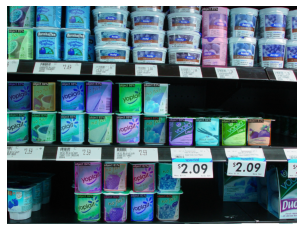

In [65]:
img = cv2.imread(annotated_images[41])

plt.imshow(img)
plt.axis('off')